#  3.3 Open Exploration with 5 Objectives

##  3.3.1 Open Exploration of 5 Objectives Problem Formulation with No Policy Levers 

In [1]:
# load library

import pandas as pd
import numpy as np
import scipy as sp
import matplotlib.pyplot as plt
import seaborn as sns
import time
import statistics


In [3]:
#load EMA workbench and associated libraries 

from ema_workbench import (Model, RealParameter, ScalarOutcome, MultiprocessingEvaluator, 
                           ema_logging, Constant, Scenario, Policy, perform_experiments)
from ema_workbench import load_results
from ema_workbench.analysis import prim, dimensional_stacking, cart
from ema_workbench.util import ema_logging, utilities

ema_logging.log_to_stderr(ema_logging.INFO)


<Logger EMA (DEBUG)>

In [4]:
# no policy base case

from model.dike_model_function import DikeNetwork  # @UnresolvedImport
from model.problem_formulation import get_model_for_problem_formulation

dike_model, planning_steps = get_model_for_problem_formulation(2)

# Setting policy levers to zero
policies = [Policy("No policy-Base Case", **{k.name: 0 for k in dike_model.levers})]


In [4]:
#Experimentation run of 1000 scenarios with zero policy

# start_time = time.time()

# with MultiprocessingEvaluator(dike_model) as evaluator:
#     results = evaluator.perform_experiments(scenarios=1000, policies=policies)

# end_time = time.time()

# print('Total run time:{} min'.format((end_time - start_time)/60))

# # Save the results
# utilities.save_results(results, 'results/base_case_no_policy.csv')


[MainProcess/INFO] pool started
[MainProcess/INFO] performing 1000 scenarios * 1 policies * 1 model(s) = 1000 experiments
[MainProcess/INFO] 100 cases completed
[MainProcess/INFO] 200 cases completed
[MainProcess/INFO] 300 cases completed
[MainProcess/INFO] 400 cases completed
[MainProcess/INFO] 500 cases completed
[MainProcess/INFO] 600 cases completed
[MainProcess/INFO] 700 cases completed
[MainProcess/INFO] 800 cases completed
[MainProcess/INFO] 900 cases completed
[MainProcess/INFO] 1000 cases completed
[MainProcess/INFO] experiments finished
[MainProcess/INFO] terminating pool
[MainProcess/INFO] results saved successfully to c:\Users\pratheepkumaar\Documents\GitHub\EPA1361\final_assignment\results\base_case_no_policy.csv
Total run time:11.336907418568929 min


In [5]:
#load the results
base_case_results = utilities.load_results('results/base_case_no_policy.csv')

experiments, outcomes = base_case_results
outcomes = pd.DataFrame(outcomes)
experiments = pd.DataFrame(experiments)

results = experiments.join(outcomes)
results = results.drop(columns="model")
results

[MainProcess/INFO] results loaded succesfully from c:\Users\pratheepkumaar\Documents\GitHub\EPA1361\final_assignment\results\base_case_no_policy.csv


,A.0_ID flood wave shape,A.1_Bmax,A.1_Brate,A.1_pfail,A.2_Bmax,A.2_Brate,A.2_pfail,A.3_Bmax,A.3_Brate,A.3_pfail,...,A.5_DikeIncrease 0,A.5_DikeIncrease 1,A.5_DikeIncrease 2,scenario,policy,Expected Annual Damage,Dike Investment Costs,RfR Investment Costs,Evacuation Costs,Expected Number of Deaths
0,30.0,152.116218,1.5,0.734203,34.576898,1.0,0.116138,325.126631,1.5,0.029576,...,0.0,0.0,0.0,0,No policy-Base Case,2.333189e+09,0,0.0,0.0,4.130067
1,40.0,240.190245,1.5,0.351591,101.853813,10.0,0.397905,302.989234,1.0,0.106684,...,0.0,0.0,0.0,1,No policy-Base Case,3.949764e+09,0,0.0,0.0,4.697078
2,94.0,337.468196,1.0,0.793213,297.364129,10.0,0.104833,289.617448,1.0,0.939069,...,0.0,0.0,0.0,2,No policy-Base Case,7.448462e+08,0,0.0,0.0,0.603269
3,116.0,74.553547,10.0,0.354368,218.905846,10.0,0.023172,89.449561,1.0,0.292356,...,0.0,0.0,0.0,3,No policy-Base Case,2.901479e+09,0,0.0,0.0,2.164491
4,111.0,307.732289,1.0,0.017510,167.274467,1.5,0.471018,31.966658,10.0,0.303344,...,0.0,0.0,0.0,4,No policy-Base Case,2.458933e+09,0,0.0,0.0,1.911396
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,2.0,288.378073,1.0,0.364674,334.393216,1.5,0.310031,79.962514,1.5,0.938872,...,0.0,0.0,0.0,995,No policy-Base Case,2.032555e+09,0,0.0,0.0,1.410672
996,118.0,118.267648,1.5,0.553985,332.577177,1.5,0.981977,202.832781,1.0,0.968671,...,0.0,0.0,0.0,996,No policy-Base Case,3.365063e+08,0,0.0,0.0,0.174225
997,89.0,145.538477,10.0,0.536342,161.087385,1.0,0.150728,193.161492,1.0,0.536744,...,0.0,0.0,0.0,997,No policy-Base Case,4.812940e+08,0,0.0,0.0,0.558250
998,41.0,209.012996,10.0,0.159177,266.112163,1.5,0.592921,348.956040,1.0,0.506417,...,0.0,0.0,0.0,998,No policy-Base Case,2.809194e+09,0,0.0,0.0,1.913216


## 3.3.1 Open Exploration of 5 Objectives Problem Formulation with Policy Levers 



In [6]:
#Setting PF = 2 in problem_formulation.py to get 5 outcomes

dike_model, planning_steps = get_model_for_problem_formulation(2)

In [13]:
#Experimentation run with 1000 scenarios and 25 policies

# tic = time.time()

# with MultiprocessingEvaluator(dike_model) as evaluator:
#    results_25 = evaluator.perform_experiments(scenarios=1000, policies=25)

# toc = time.time()

# print('Total run time:{} min'.format((toc - tic)/60))

# # Save the results
# utilities.save_results(results_25, 'results/base_case_25.csv')


[MainProcess/INFO] pool started
[MainProcess/INFO] performing 1000 scenarios * 25 policies * 1 model(s) = 25000 experiments
[MainProcess/INFO] 2500 cases completed
[MainProcess/INFO] 5000 cases completed
[MainProcess/INFO] 7500 cases completed
[MainProcess/INFO] 10000 cases completed
[MainProcess/INFO] 12500 cases completed
[MainProcess/INFO] 15000 cases completed
[MainProcess/INFO] 17500 cases completed
[MainProcess/INFO] 20000 cases completed
[MainProcess/INFO] 22500 cases completed
[MainProcess/INFO] 25000 cases completed
[MainProcess/INFO] experiments finished
[MainProcess/INFO] terminating pool
Total run time:199.76829303503035 min
[MainProcess/INFO] results saved successfully to c:\Users\pratheepkumaar\Documents\GitHub\EPA1361\final_assignment\results\base_case_25.csv


In [46]:
#loading the results

results_25 = utilities.load_results('results/base_case_25.csv')

experiments_25, outcomes_25 = results_25
outcomes_25 = pd.DataFrame(outcomes_25)
experiments_2 = pd.DataFrame(experiments_25)

results_25 = experiments_25.join(outcomes_25)
results_25


[MainProcess/INFO] results loaded succesfully from c:\Users\pratheepkumaar\Documents\GitHub\EPA1361\final_assignment\results\base_case_25.csv


,A.0_ID flood wave shape,A.1_Bmax,A.1_Brate,A.1_pfail,A.2_Bmax,A.2_Brate,A.2_pfail,A.3_Bmax,A.3_Brate,A.3_pfail,...,A.5_DikeIncrease 2,EWS_DaysToThreat,scenario,policy,model,Expected Annual Damage,Dike Investment Costs,RfR Investment Costs,Evacuation Costs,Expected Number of Deaths
0,72.0,229.065066,1.0,0.046967,223.668730,1.0,0.959957,313.581649,1.0,0.094915,...,7.0,1.0,1000,0,dikesnet,1.276686e+08,7.242345e+08,1.305500e+09,2261.612172,0.057127
1,116.0,33.749286,1.0,0.315966,325.813725,10.0,0.002073,337.906842,1.5,0.902318,...,7.0,1.0,1001,0,dikesnet,3.376730e+06,7.242345e+08,1.305500e+09,85.845296,0.001151
2,89.0,154.258454,10.0,0.579020,210.092981,10.0,0.295155,68.942692,1.0,0.034387,...,7.0,1.0,1002,0,dikesnet,4.401415e+08,7.242345e+08,1.305500e+09,10644.762897,0.249753
3,62.0,192.404949,1.5,0.537800,153.666509,10.0,0.327101,253.606447,1.0,0.792516,...,7.0,1.0,1003,0,dikesnet,3.714329e+07,7.242345e+08,1.305500e+09,1126.394452,0.011669
4,19.0,206.441001,10.0,0.738176,52.302399,1.0,0.264023,224.214285,1.0,0.769407,...,7.0,1.0,1004,0,dikesnet,7.810257e+06,7.242345e+08,1.305500e+09,355.878927,0.003826
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24995,4.0,290.080042,1.0,0.405025,122.982257,10.0,0.914892,111.896810,1.5,0.272958,...,1.0,2.0,1995,24,dikesnet,4.096309e+06,6.434561e+08,1.086000e+09,179.241920,0.001343
24996,65.0,106.054469,1.5,0.961497,185.190144,1.5,0.017885,277.261505,1.5,0.230139,...,1.0,2.0,1996,24,dikesnet,1.108645e+07,6.434561e+08,1.086000e+09,387.834583,0.002887
24997,6.0,74.906684,1.0,0.859558,278.084608,10.0,0.680525,78.511368,1.5,0.581816,...,1.0,2.0,1997,24,dikesnet,0.000000e+00,6.434561e+08,1.086000e+09,0.000000,0.000000
24998,53.0,127.422450,1.5,0.664705,330.008863,1.5,0.120276,311.819030,1.0,0.610247,...,1.0,2.0,1998,24,dikesnet,2.832309e+07,6.434561e+08,1.086000e+09,1646.307985,0.001681


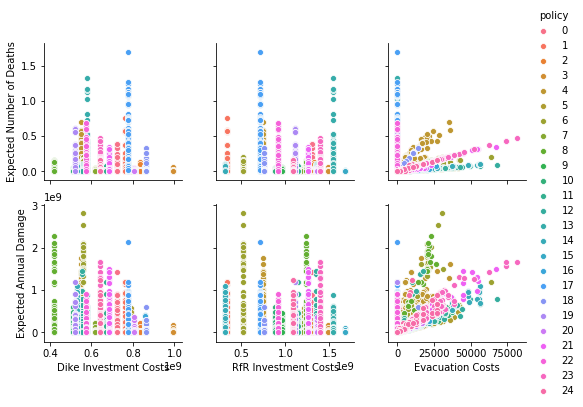

In [10]:
#PLotting scatter plots to visualize correlation between outcomes.

g = sns.pairplot(results_25,hue='policy',
                 x_vars=["Dike Investment Costs", "RfR Investment Costs","Evacuation Costs"],
                 y_vars=["Expected Number of Deaths", "Expected Annual Damage"])

In [9]:
#Structuring the dataframe for further analysis

outcomes_25 = pd.DataFrame(outcomes_25)
experiments_25 = pd.DataFrame(experiments_25)

results = experiments_25.join(outcomes_25)
results = results.drop(columns="model")

In [10]:
#Aggregating(Mean) the 5 outcomes with respect to the 25 policies

def mean(data):
    m = np.mean(data)
    return m

res_25 = pd.DataFrame(columns=["policy", "Mean Dike Investment Costs", "Mean RfR Investment Costs", "Mean Evacuation Costs", "Mean Expected Number of Deaths", "Mean Expected Annual Damage"])

d1 = []
d2 = []
d3 = []
d4 = []
d5 = []
for p in results["policy"].unique():
    result = []
    index = results[results["policy"] == p].index
    
    dike = mean(results["Dike Investment Costs"][index])
    rfr = mean(results["RfR Investment Costs"][index])
    evac = mean(results["Evacuation Costs"][index])
    death = mean(results["Expected Number of Deaths"][index])
    damage = mean(results["Expected Annual Damage"][index])
        
    result = [str(p), dike, rfr, evac, death, damage]
    
    res_25 = res_25.append(pd.Series(result, index=["policy", "Mean Dike Investment Costs", "Mean RfR Investment Costs", "Mean Evacuation Costs", "Mean Expected Number of Deaths", "Mean Expected Annual Damage"]), ignore_index=True) 

    
res_25

,policy,Mean Dike Investment Costs,Mean RfR Investment Costs,Mean Evacuation Costs,Mean Expected Number of Deaths,Mean Expected Annual Damage
0,0,7.242345e+08,1.305500e+09,1269.270510,0.029928,5.573015e+07
1,1,7.619251e+08,3.390000e+08,0.000000,0.068423,1.019914e+08
2,2,8.354878e+08,1.324200e+09,42.685357,0.001063,1.653031e+06
3,3,9.939158e+08,1.488100e+09,28.564324,0.000333,1.024586e+06
4,4,5.522342e+08,7.470000e+08,3344.290740,0.070838,1.664210e+08
5,5,7.909739e+08,1.215000e+09,4112.701480,0.005670,5.085952e+07
6,6,5.578211e+08,5.233000e+08,3457.924282,0.009756,9.857459e+07
7,7,6.169686e+08,1.172300e+09,209.711689,0.000546,3.277290e+06
8,8,4.181120e+08,1.233700e+09,2434.655176,0.005924,6.482586e+07
9,9,7.749016e+08,9.589000e+08,2074.221516,0.005473,4.081067e+07


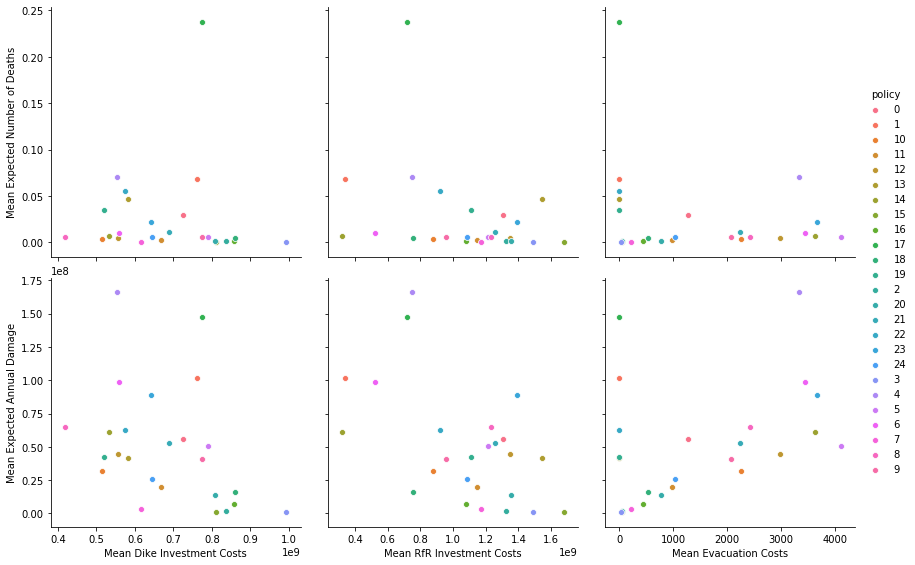

In [11]:
#PLotting scatter plots to visualize correlation between mean of the outcomes.

g = sns.pairplot(res_25,hue='policy',height = 4,
                 x_vars=["Mean Dike Investment Costs", "Mean RfR Investment Costs","Mean Evacuation Costs"],
                 y_vars=["Mean Expected Number of Deaths", "Mean Expected Annual Damage"])

## 3.3.2 Sensitivity Analysis 


In [12]:
f#Loading required the results from previous run

from ema_workbench import load_results

experiments, outcomes = load_results('results/base_case_25.csv')

[MainProcess/INFO] results loaded succesfully from c:\Users\pratheepkumaar\Documents\GitHub\EPA1361\final_assignment\results\base_case_25.csv


[MainProcess/INFO] model dropped from analysis because only a single category
[MainProcess/INFO] model dropped from analysis because only a single category
[MainProcess/INFO] model dropped from analysis because only a single category
[MainProcess/INFO] model dropped from analysis because only a single category
[MainProcess/INFO] model dropped from analysis because only a single category


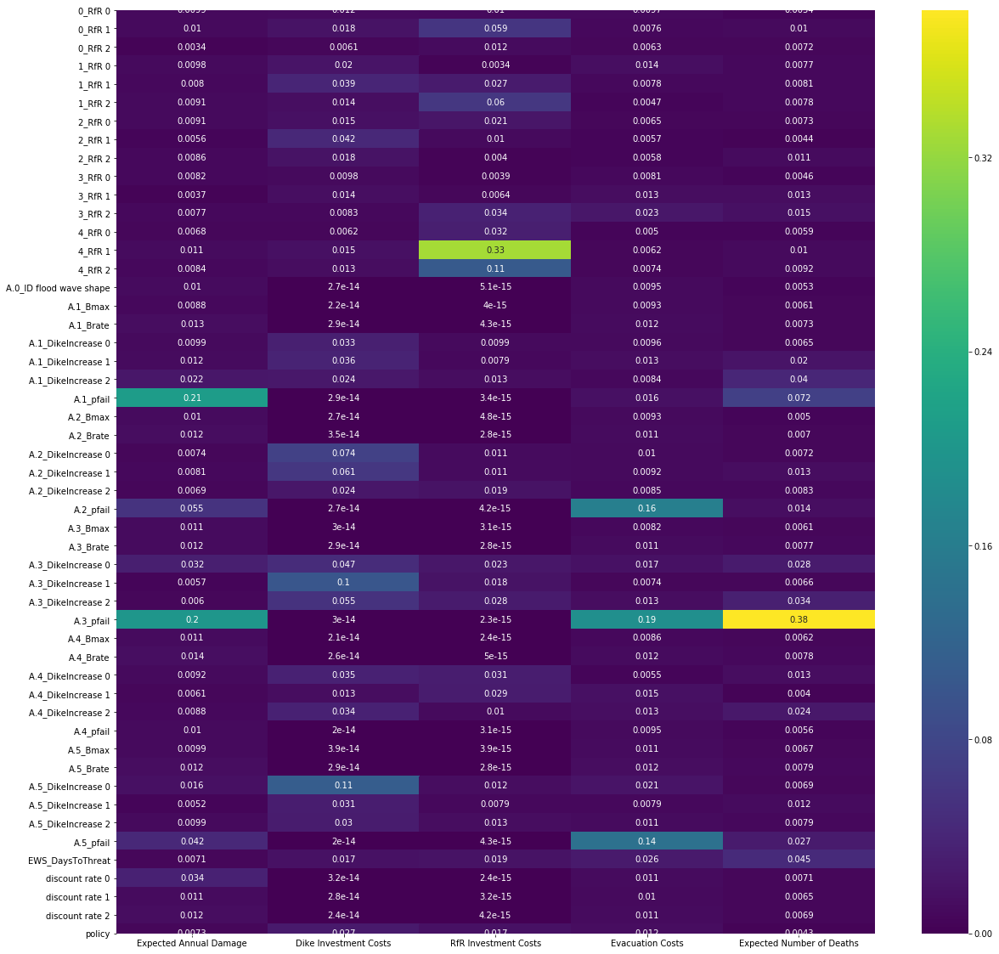

In [13]:
# feature scoring analysis included in the EMA workbench
from ema_workbench.analysis import feature_scoring
 
a = experiments
b = outcomes

feat_score = feature_scoring.get_feature_scores_all(a, b)

fig, ax = plt.subplots(figsize=(20,20))         
sns.heatmap(feat_score, cmap='viridis', annot=True)

plt.show()

In [33]:
# Saving the above figure
fig.savefig('results/feature_scoring_5obj_25policies')

In [23]:
from ema_workbench import load_results

experiments, outcomes = load_results('results/base_case_no_policy.csv')

[MainProcess/INFO] results loaded succesfully from c:\Users\pratheepkumaar\Documents\GitHub\EPA1361\final_assignment\results\base_case_no_policy.csv


[MainProcess/INFO] policy dropped from analysis because only a single category
[MainProcess/INFO] model dropped from analysis because only a single category
[MainProcess/INFO] policy dropped from analysis because only a single category
[MainProcess/INFO] model dropped from analysis because only a single category
[MainProcess/INFO] policy dropped from analysis because only a single category
[MainProcess/INFO] model dropped from analysis because only a single category
[MainProcess/INFO] policy dropped from analysis because only a single category
[MainProcess/INFO] model dropped from analysis because only a single category
[MainProcess/INFO] policy dropped from analysis because only a single category
[MainProcess/INFO] model dropped from analysis because only a single category


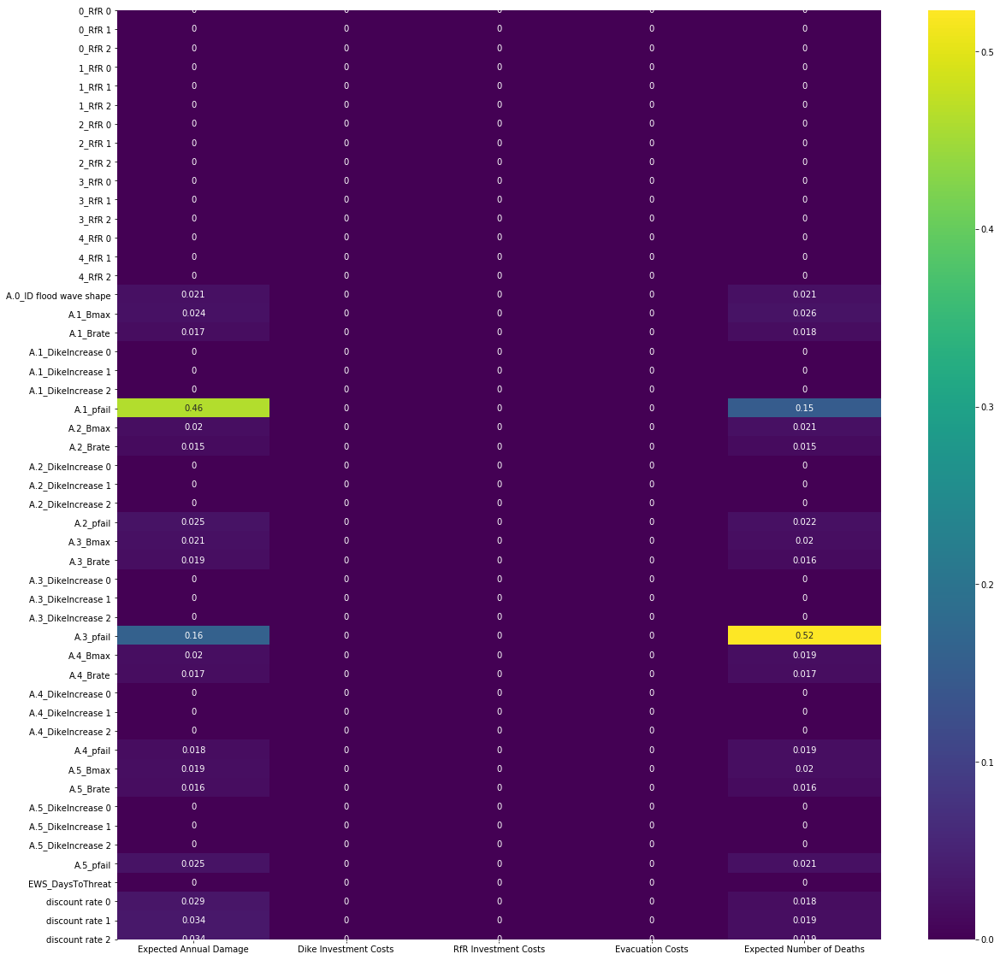

In [24]:
from ema_workbench.analysis import feature_scoring
 
a = experiments
b = outcomes

feat_score = feature_scoring.get_feature_scores_all(a, b)

fig, ax = plt.subplots(figsize=(20,20))         
sns.heatmap(feat_score, cmap='viridis', annot=True)

plt.show()

In [34]:
fig.savefig('results/feature_scoring_5obj_0policies')